In [7]:
import warnings
import base64
from IPython.display import HTML, display

warnings.simplefilter(action='ignore')

In [20]:
from huggingface_hub import login

login(token="")

!huggingface-cli whoami

yauhenim


In [5]:
def play_audio_in_notebook(file_path):
    with open(file_path, "rb") as f:
        audio_data = f.read()
    b64_audio = base64.b64encode(audio_data).decode()
    audio_html = f'''
    <audio controls>
      <source src="data:audio/wav;base64,{b64_audio}" type="audio/wav">
      Ваш браузер не поддерживает аудио.
    </audio>
    '''
    display(HTML(audio_html))

## 1. Text-to-speech

### 1.1 microsoft/speecht5_tts

In [24]:
!rm -rf ~/.cache/huggingface/datasets/Matthijs--cmu-arctic-xvectors
!pip install -U datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 494.8/494.8 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.6/193.6 kB 11.3 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2025.7.0
    Uninstalling fsspec-2025.7.0:
      Successfully uninstalled fsspec-2025.7.0
  Attempting uninstall: datasets
    Found existing installation: datasets 2.14.4
    Uninstalling datasets-2.14.4:
      Successfully uninstalled datasets-2.14.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 25.6.0 requires pandas<2.2.4dev0,>=2.0, but you have pandas 1.5.3 which is incompatible.
gcsfs 2025.7.0 requires fsspec==2025.7.0, but you have fsspec 2025.3.0 which is incompatible.
sentence-transformers 4.1.0 requires transformers<5.0.0,>=4.41.0, but you have transformers 4.33.3 which is incompatible.
dask-cudf-cu12 25.6.0 req

In [1]:
import torch
from transformers import pipeline
from datasets import load_dataset
import soundfile as sf

embeddings_dataset = load_dataset("Matthijs/cmu-arctic-xvectors", split="validation")

synthesiser = pipeline("text-to-speech", "microsoft/speecht5_tts")

embeddings_dataset = load_dataset("Matthijs/cmu-arctic-xvectors", split="validation")
speaker_embedding = torch.tensor(embeddings_dataset[7306]["xvector"]).unsqueeze(0)

speech = synthesiser("It took me quite a long time to develop a voice, and now that I have it I'm not going to be silent.", forward_params={"speaker_embeddings": speaker_embedding})

sf.write("speech.wav", speech["audio"], samplerate=speech["sampling_rate"])

/usr/local/lib/python3.11/dist-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md: 0.00B [00:00, ?B/s]

cmu-arctic-xvectors.py: 0.00B [00:00, ?B/s]

Using the latest cached version of the dataset since Matthijs/cmu-arctic-xvectors couldn't be found on the Hugging Face Hub
Found the latest cached dataset configuration 'default' at /root/.cache/huggingface/datasets/Matthijs___cmu-arctic-xvectors/default/0.0.1/a62fea1f9415e240301ea0042ffad2a3aadf4d1caa7f9a8d9512d631723e781f (last modified on Wed Jul 23 10:16:07 2025).
/usr/local/lib/python3.11/dist-packages/huggingface_hub/file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/585M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/232 [00:00<?, ?B/s]

spm_char.model:   0%|          | 0.00/238k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/40.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/234 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/433 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/636 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/50.7M [00:00<?, ?B/s]

Using the latest cached version of the dataset since Matthijs/cmu-arctic-xvectors couldn't be found on the Hugging Face Hub
Found the latest cached dataset configuration 'default' at /root/.cache/huggingface/datasets/Matthijs___cmu-arctic-xvectors/default/0.0.1/a62fea1f9415e240301ea0042ffad2a3aadf4d1caa7f9a8d9512d631723e781f (last modified on Wed Jul 23 10:16:07 2025).


In [6]:
play_audio_in_notebook("/content/speech.wav")

In [ ]:
# Если надо закодировать в формат mono 16k Hz
!ffmpeg -i /content/speech.wav -ac 1 -ar 16000 /content/speech_16k_mono.wav

### 1.2 coqui/XTTS-v2

In [1]:
!pip install TTS transformers==4.33.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.5/73.5 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 44.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.6/101.6 kB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.3/15.3 MB 86.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 17.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.4/31.4 MB 11.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 76.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.

In [12]:
# Лист 🐸TTS models
models_file=TTS.get_models_file_path()
print(models_file)

/usr/local/lib/python3.11/dist-packages/TTS/.models.json


In [8]:
import torch
from TTS.api import TTS

# Обёртка для загрузки классов, если доверям источкину (torch>=2.6)
_original_torch_load = torch.load

def patched_torch_load(*args, **kwargs):
    if 'weights_only' not in kwargs:
        kwargs['weights_only'] = False
    return _original_torch_load(*args, **kwargs)

torch.load = patched_torch_load


device = "cuda" if torch.cuda.is_available() else "cpu"


# Если надо разрешать только отдельные классы для torch >= 2.6

'''
from TTS.tts.configs.xtts_config import XttsConfig, XttsAudioConfig
from torch.serialization import safe_globals

with safe_globals([XttsConfig, XttsAudioConfig]):
   tts = TTS("tts_models/multilingual/multi-dataset/xtts_v2").to(device)
'''

tts = TTS("tts_models/multilingual/multi-dataset/xtts_v2").to(device)

# Список значений амплитуды текста в речи как вывод
wav = tts.tts(
    text="It took me quite a long time to develop a voice, and now that I have it I'm not going to be silent.",
    speaker_wav="/content/en_sample.wav", language="en"
    )
# Text-to-speech в файл
tts.tts_to_file(
    text="It took me quite a long time to develop a voice, and now that I have it I'm not going to be silent.",
    speaker_wav="/content/en_sample.wav", language="en", file_path="output.wav"
    )

/usr/local/lib/python3.11/dist-packages/TTS/.models.json
 > tts_models/multilingual/multi-dataset/xtts_v2 is already downloaded.


/usr/local/lib/python3.11/dist-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(


 > Using model: xtts


In [20]:
play_audio_in_notebook("/content/output.wav")

In [9]:
tts.tts_to_file(
    text="It took me quite a long time to develop a voice, and now that I have it I'm not going to be silent.",
    speaker_wav="/content/Новая запись.wav", language="en", file_path="outputhehe.wav"
    )

 > Text splitted to sentences.
["It took me quite a long time to develop a voice, and now that I have it I'm not going to be silent."]
 > Processing time: 51.77374053001404
 > Real-time factor: 7.382378289490491


'outputhehe.wav'

In [11]:
play_audio_in_notebook("/content/outputhehe.wav")

## 2. Audio Classification

### 2.1 alefiury/wav2vec2-large-xlsr-53-gender-recognition-librispeech

In [13]:
from transformers import pipeline
classifier = pipeline("audio-classification", model="alefiury/wav2vec2-large-xlsr-53-gender-recognition-librispeech")
result = classifier("/content/output.wav")
print(result)

Some weights of the model checkpoint at alefiury/wav2vec2-large-xlsr-53-gender-recognition-librispeech were not used when initializing Wav2Vec2ForSequenceClassification: ['wav2vec2.encoder.pos_conv_embed.conv.weight_v', 'wav2vec2.encoder.pos_conv_embed.conv.weight_g']
- This IS expected if you are initializing Wav2Vec2ForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForSequenceClassification were not initialized from the model checkpoint at alefiury/wav2vec2-large-xlsr-53-gender-recognition-librispeech and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.p

[{'score': 0.9986131191253662, 'label': 'female'}, {'score': 0.001386897754855454, 'label': 'male'}]


### 2.2 firdhokk/speech-emotion-recognition-with-openai-whisper-large-v3

In [15]:
from transformers import pipeline
classifier2 = pipeline("audio-classification", model="firdhokk/speech-emotion-recognition-with-openai-whisper-large-v3")
result2 = classifier2("/content/output.wav")
print(result2)

[{'score': 0.9155864715576172, 'label': 'neutral'}, {'score': 0.037129323929548264, 'label': 'happy'}, {'score': 0.019625317305326462, 'label': 'angry'}, {'score': 0.017218241468071938, 'label': 'fearful'}, {'score': 0.008341972716152668, 'label': 'surprised'}]


## 3. Automatic Speech Recognition

### 3.1 facebook/wav2vec2-base-960h

In [27]:
from transformers import pipeline
asr = pipeline("automatic-speech-recognition", model="facebook/wav2vec2-base-960h")
transcription = asr("/content/output.wav")
print("Расшифровка:", transcription["text"])

with open('text.txt', 'w', encoding='utf-8') as f:
    f.write(transcription["text"])

Some weights of the model checkpoint at facebook/wav2vec2-base-960h were not used when initializing Wav2Vec2ForCTC: ['wav2vec2.encoder.pos_conv_embed.conv.weight_v', 'wav2vec2.encoder.pos_conv_embed.conv.weight_g']
- This IS expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1', 'wav2vec2.masked_spec_embed']
You sho

Расшифровка: IT TOOK ME QUITE A LONG TIME TO DEVELOP A VOICE AND NOW THAT I HAVE IT I AM NOT GOING TO BE SILENT


### 3.2 MahmoudAshraf/mms-300m-1130-forced-aligner

In [28]:
!pip install git+https://github.com/MahmoudAshraf97/ctc-forced-aligner.git

  Cloning https://github.com/MahmoudAshraf97/ctc-forced-aligner.git to /tmp/pip-req-build-6hub26yy
  Running command git clone --filter=blob:none --quiet https://github.com/MahmoudAshraf97/ctc-forced-aligner.git /tmp/pip-req-build-6hub26yy
  Resolved https://github.com/MahmoudAshraf97/ctc-forced-aligner.git to commit 201276a4ea2ddd3f5caead1ac4f211477ae3da6d
  Running command git submodule update --init --recursive -q
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.9/40.9 kB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 38.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 16.0 MB/s eta 0:00:00
  Created wheel for ctc-forced-aligner: filename=ctc_forced_aligner-0.3.0-cp311-cp311-linux_x86_64.whl size=1160275 sha256=df3f2354e9bfaa0e7f0efcf1d45d0d60bb04b7a855882ec3b95ddd3e21c73f38
  Stored in director

In [9]:
import torch
from ctc_forced_aligner import (
    load_audio,
    load_alignment_model,
    generate_emissions,
    preprocess_text,
    get_alignments,
    get_spans,
    postprocess_results,
)

audio_path = "/content/output.wav"
text_path = "/content/text.txt"
language = "iso" # ISO-639-3 Language code
device = "cuda" if torch.cuda.is_available() else "cpu"
batch_size = 16


alignment_model, alignment_tokenizer = load_alignment_model(
    device,
    dtype=torch.float16 if device == "cuda" else torch.float32,
)

audio_waveform = load_audio(audio_path, alignment_model.dtype, alignment_model.device)


with open(text_path, "r") as f:
    lines = f.readlines()
text = "".join(line for line in lines).replace("\n", " ").strip()

emissions, stride = generate_emissions(
    alignment_model, audio_waveform, batch_size=batch_size
)

tokens_starred, text_starred = preprocess_text(
    text,
    romanize=True,
    language=language,
)

segments, scores, blank_token = get_alignments(
    emissions,
    tokens_starred,
    alignment_tokenizer,
)

spans = get_spans(tokens_starred, segments, blank_token)

word_timestamps = postprocess_results(text_starred, spans, stride, scores)
word_timestamps

[{'start': 0.021, 'end': 0.063, 'text': 'IT', 'score': -0.0008067024173215032},
 {'start': 0.126,
  'end': 0.252,
  'text': 'TOOK',
  'score': -0.0007818354642949998},
 {'start': 0.315, 'end': 0.336, 'text': 'ME', 'score': -0.0004996005445718765},
 {'start': 0.441,
  'end': 0.693,
  'text': 'QUITE',
  'score': -0.021077651530504227},
 {'start': 0.735, 'end': 0.735, 'text': 'A', 'score': 0.0},
 {'start': 0.798, 'end': 0.966, 'text': 'LONG', 'score': -0.16137991845607758},
 {'start': 1.029, 'end': 1.281, 'text': 'TIME', 'score': -0.37798964977264404},
 {'start': 1.323, 'end': 1.365, 'text': 'TO', 'score': -0.09133211523294449},
 {'start': 1.428,
  'end': 1.764,
  'text': 'DEVELOP',
  'score': -0.014529868960380554},
 {'start': 1.848, 'end': 1.848, 'text': 'A', 'score': 0.0},
 {'start': 1.911,
  'end': 2.289,
  'text': 'VOICE',
  'score': -0.009536570869386196},
 {'start': 2.772, 'end': 2.835, 'text': 'AND', 'score': -0.3618772327899933},
 {'start': 2.919,
  'end': 3.024,
  'text': 'NOW',

### 3.3 pyannote/voice-activity-detection

In [5]:
!pip install pyannote.audio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.7/898.7 kB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 821.1/821.1 kB 31.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.5/58.5 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.1/48.1 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.4/51.4 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.9/125.9 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 864.1/864.1 kB 34.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.5/48.5 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 963.5/963.5 kB 35.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 17.8 MB/s eta 0:00:00
   ━

torch.Size([1, 135696]) 24000
0.0s - 5.1s: SPEAKER_00


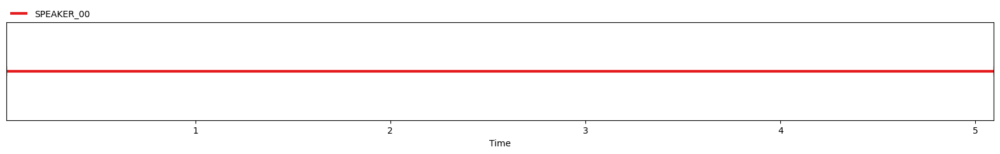

In [23]:
from pyannote.audio import Pipeline
pipeline = Pipeline.from_pretrained(
  "pyannote/speaker-diarization-3.1",
  #use_auth_token=""  Нужно если не залогинился
  )

diarization = pipeline("/content/output.wav")

# dump the diarization output to disk using RTTM format
#with open("audio.rttm", "w") as rttm:
#    diarization.write_rttm(rttm)

import torchaudio
waveform, sample_rate = torchaudio.load("/content/output.wav")
print(waveform.shape, sample_rate)

for turn, _, speaker in diarization.itertracks(yield_label=True):
    print(f"{turn.start:.1f}s - {turn.end:.1f}s: {speaker}")

diarization

## 4. Text-to-Audio

### 4.1 facebook/musicgen-medium

In [1]:
from transformers import pipeline
import scipy

synthesiser = pipeline("text-to-audio", "facebook/musicgen-medium")
music = synthesiser(
    "lo-fi music with a soothing melody",
    forward_params={"do_sample": True}
)

scipy.io.wavfile.write("musicgen_out.wav", rate=music["sampling_rate"], data=music["audio"])

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Device set to use cuda:0


In [6]:
play_audio_in_notebook("/content/musicgen_out.wav")

ИЛИ

In [4]:
!pip install transformers==4.33.3 audiocraft numpy==1.26.4

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 635.7/635.7 kB 38.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.4/72.4 kB 8.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 7.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 67.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 86.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.1/87.1 kB 9.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
INFO: pip is looking at multiple versions of torchaudio to determine which version is c

In [2]:
#medium

from audiocraft.models import musicgen
from audiocraft.utils.notebook import display_audio
import torch

model = musicgen.MusicGen.get_pretrained('medium', device='cuda')
model.set_generation_params(duration=8)

res = model.generate([
    'crazy EDM, heavy bang',
    'classic reggae track with an electronic guitar solo',
    'lofi slow bpm electro chill with organic samples',
    'rock with saturated guitars, a heavy bass line and crazy drum break and fills.',
    'earthy tones, environmentally conscious, ukulele-infused, harmonic, breezy, easygoing, organic instrumentation, gentle grooves',
],
    progress=True)
display_audio(res, 32000)

In [3]:
#large

model = musicgen.MusicGen.get_pretrained('large', device='cuda')
model.set_generation_params(duration=8)

res2 = model.generate([
    'crazy EDM, heavy bang',
    'classic reggae track with an electronic guitar solo',
    'lofi slow bpm electro chill with organic samples',
    'rock with saturated guitars, a heavy bass line and crazy drum break and fills.',
    'earthy tones, environmentally conscious, ukulele-infused, harmonic, breezy, easygoing, organic instrumentation, gentle grooves',
],
    progress=True)
display_audio(res2, 32000)

state_dict.bin:   0%|          | 0.00/6.51G [00:00<?, ?B/s]

compression_state_dict.bin:   0%|          | 0.00/236M [00:00<?, ?B/s]

### 4.2 ASLP-lab/DiffRhythm-base

In [1]:
#demo space https://huggingface.co/spaces/ASLP-lab/DiffRhythm

!git clone https://github.com/ASLP-lab/DiffRhythm.git
%cd DiffRhythm

!apt-get update
!apt-get install -y espeak-ng

!pip install -r requirements.txt

import sys
sys.path.append('.')

Cloning into 'DiffRhythm'...
remote: Enumerating objects: 407, done.
remote: Counting objects: 100% (154/154), done.
remote: Compressing objects: 100% (77/77), done.
remote: Total 407 (delta 118), reused 77 (delta 77), pack-reused 253 (from 2)
Receiving objects: 100% (407/407), 138.62 MiB | 20.72 MiB/s, done.
Resolving deltas: 100% (167/167), done.
Updating files: 100% (88/88), done.
/content/DiffRhythm
Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu j

In [2]:
!bash /content/DiffRhythm/scripts/infer_wav_ref.sh

Current working directory: /content/DiffRhythm
2025-07-23 15:08:54.324816: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1753283334.572986    2264 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1753283334.642564    2264 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-07-23 15:08:55.159364: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
cfm_model.pt: 100% 2.22G/2.22G [00:56<00:00, 39.0MB/s]
./g2p/sources/g

In [8]:
play_audio_in_notebook("/content/DiffRhythm/infer/example/output/output.wav")